# BPI Challenge 2017

This Notebook is going to be used to analyze the BPI challenge dataset. In order to understand the event logs and the process, then we will use some Process Mining techniques to detect possible frauds in the processes. 

## Data Reading

In [1]:
# Import the necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pm4py

In [2]:
import os

# Load the current directory
base_dir = os.getcwd()
file_path = os.path.join(base_dir, "BPI Challenge 2017_1_all/BPI Challenge 2017.xes.gz")

log = pm4py.read_xes(file_path)

parsing log, completed traces ::   0%|          | 0/31509 [00:00<?, ?it/s]

In [3]:
# event_log data frame
event_log = pm4py.convert_to_dataframe(log)

In [4]:
event_log.keys()

Index(['Action', 'org:resource', 'concept:name', 'EventOrigin', 'EventID',
       'lifecycle:transition', 'time:timestamp', 'case:LoanGoal',
       'case:ApplicationType', 'case:concept:name', 'case:RequestedAmount',
       'FirstWithdrawalAmount', 'NumberOfTerms', 'Accepted', 'MonthlyCost',
       'Selected', 'CreditScore', 'OfferedAmount', 'OfferID'],
      dtype='object')

In [5]:
event_log.iloc[[1,2,9,10,11,12]]

,Action,org:resource,concept:name,EventOrigin,EventID,lifecycle:transition,time:timestamp,case:LoanGoal,case:ApplicationType,case:concept:name,case:RequestedAmount,FirstWithdrawalAmount,NumberOfTerms,Accepted,MonthlyCost,Selected,CreditScore,OfferedAmount,OfferID
1,statechange,User_1,A_Submitted,Application,ApplState_1582051990,complete,2016-01-01 09:51:15.352000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Created,User_1,W_Handle leads,Workflow,Workitem_1298499574,schedule,2016-01-01 09:51:15.774000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Created,User_52,O_Create Offer,Offer,Offer_148581083,complete,2016-01-02 11:29:03.994000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,20000.0,44.0,True,498.29,True,979.0,20000.0,NaN
10,statechange,User_52,O_Created,Offer,OfferState_1514834199,complete,2016-01-02 11:29:05.354000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Offer_148581083
11,statechange,User_52,O_Sent (mail and online),Offer,OfferState_2051164740,complete,2016-01-02 11:30:28.606000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Offer_148581083
12,Deleted,User_52,W_Complete application,Workflow,Workitem_1007505836,ate_abort,2016-01-02 11:30:28.621000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
# Amount of data, columns and their types. 
event_log.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1202267 entries, 0 to 1202266
Data columns (total 19 columns):
 #   Column                 Non-Null Count    Dtype              
---  ------                 --------------    -----              
 0   Action                 1202267 non-null  object             
 1   org:resource           1202267 non-null  object             
 2   concept:name           1202267 non-null  object             
 3   EventOrigin            1202267 non-null  object             
 4   EventID                1202267 non-null  object             
 5   lifecycle:transition   1202267 non-null  object             
 6   time:timestamp         1202267 non-null  datetime64[ns, UTC]
 7   case:LoanGoal          1202267 non-null  object             
 8   case:ApplicationType   1202267 non-null  object             
 9   case:concept:name      1202267 non-null  object             
 10  case:RequestedAmount   1202267 non-null  float64            
 11  FirstWithdrawalAmount  4

In [7]:
# Number of Applications
event_log['case:concept:name'].nunique()

31509

In [8]:
# Unique activities
event_log['concept:name'].nunique()

26

In [9]:
# Top 3 most frequent activities
event_log['concept:name'].value_counts().head(5)


concept:name
W_Validate application     209496
W_Call after offers        191092
W_Call incomplete files    168529
W_Complete application     148900
W_Handle leads              47264
Name: count, dtype: int64

In [10]:
# Least frequent activities
event_log['concept:name'].value_counts().tail(5)

concept:name
A_Denied                      3753
W_Assess potential fraud      3282
O_Sent (online only)          2026
W_Shortened completion         238
W_Personal Loan collection      22
Name: count, dtype: int64

In [11]:
# Average Event per case
event_log.groupby('case:concept:name').size().mean()

38.15630454790695

In [12]:
# Average Activities per Case:
event_log.groupby('case:concept:name')['concept:name'].nunique().mean()

15.532324097876797

In [13]:
# Average Case duration
event_log.groupby('case:concept:name').agg({'time:timestamp': ['min', 'max']}).apply(lambda x: x['time:timestamp']['max'] - x['time:timestamp']['min'], axis=1).mean()

Timedelta('21 days 21:35:25.923069948')

In [14]:
# Number of different paths
event_log.groupby('case:concept:name')['concept:name'].apply(lambda x: '->'.join(x)).nunique()

15930

In [15]:
# Checking the missing values. 
event_log.isnull().sum().sort_values(ascending=False)

OfferedAmount            1159272
CreditScore              1159272
Selected                 1159272
MonthlyCost              1159272
Accepted                 1159272
NumberOfTerms            1159272
FirstWithdrawalAmount    1159272
OfferID                  1051413
case:RequestedAmount           0
Action                         0
org:resource                   0
case:ApplicationType           0
case:LoanGoal                  0
time:timestamp                 0
lifecycle:transition           0
EventID                        0
EventOrigin                    0
concept:name                   0
case:concept:name              0
dtype: int64

We are going to observe the null data, in order to understand better the dataset.

In [16]:
# Check the values of Event Origin
event_log['EventOrigin'].value_counts()

EventOrigin
Workflow       768823
Application    239595
Offer          193849
Name: count, dtype: int64

In [17]:
event_log[event_log['EventOrigin'] == 'Offer'].isnull().sum().sort_values(ascending=False)

OfferedAmount            150854
CreditScore              150854
Selected                 150854
MonthlyCost              150854
Accepted                 150854
NumberOfTerms            150854
FirstWithdrawalAmount    150854
OfferID                   42995
case:RequestedAmount          0
Action                        0
org:resource                  0
case:ApplicationType          0
case:LoanGoal                 0
time:timestamp                0
lifecycle:transition          0
EventID                       0
EventOrigin                   0
concept:name                  0
case:concept:name             0
dtype: int64

In [18]:
event_log[event_log['EventOrigin'] == 'Workflow'].isnull().sum().sort_values(ascending=False)

OfferID                  768823
OfferedAmount            768823
CreditScore              768823
Selected                 768823
MonthlyCost              768823
Accepted                 768823
NumberOfTerms            768823
FirstWithdrawalAmount    768823
case:RequestedAmount          0
Action                        0
org:resource                  0
case:ApplicationType          0
case:LoanGoal                 0
time:timestamp                0
lifecycle:transition          0
EventID                       0
EventOrigin                   0
concept:name                  0
case:concept:name             0
dtype: int64

In [19]:
event_log[event_log['EventOrigin'] == 'Application'].isnull().sum().sort_values(ascending=False)

OfferID                  239595
OfferedAmount            239595
CreditScore              239595
Selected                 239595
MonthlyCost              239595
Accepted                 239595
NumberOfTerms            239595
FirstWithdrawalAmount    239595
case:RequestedAmount          0
Action                        0
org:resource                  0
case:ApplicationType          0
case:LoanGoal                 0
time:timestamp                0
lifecycle:transition          0
EventID                       0
EventOrigin                   0
concept:name                  0
case:concept:name             0
dtype: int64

In the case of Workflow the null data is only because this data are data related to the offer and the application, not to the process workflow. In the case, of application is the same: the same length of application data is the same length of the null values in the 
offer related data. So, we can assume that the null values are attributes associated to the offer process.

The evolution of the data is going to be visualized in order to understand the process.

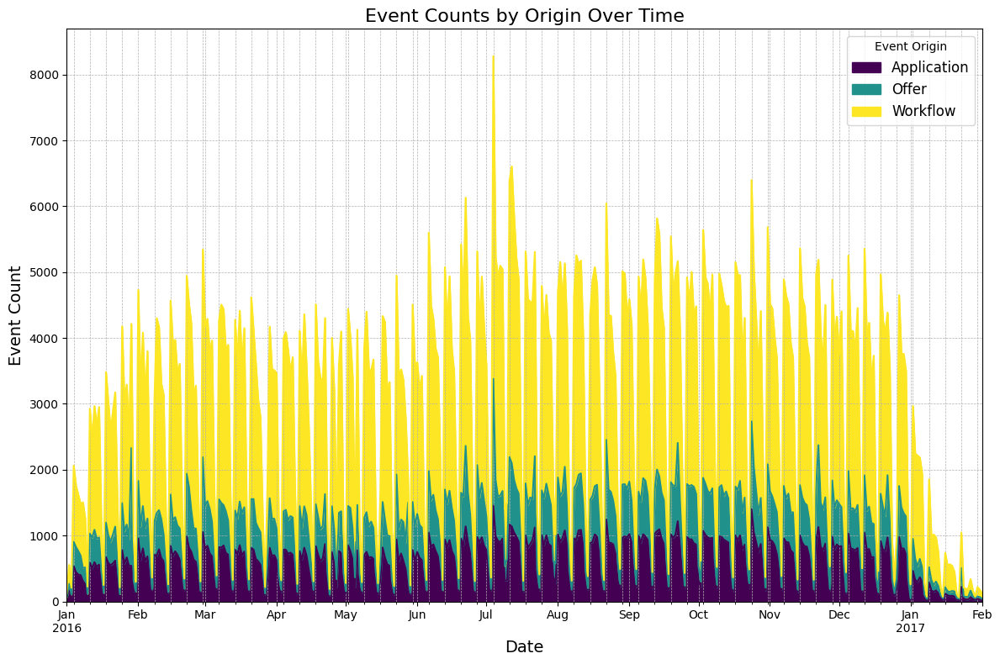

In [20]:
data = event_log.groupby(['time:timestamp', 'EventOrigin']).size().unstack().fillna(0).resample('D').sum()

# Create the plot
fig, ax = plt.subplots(figsize=(12, 8))
data.plot.area(ax=ax, colormap='viridis')

# Enhance the plot with titles and labels
ax.set_title('Event Counts by Origin Over Time', fontsize=16)
ax.set_xlabel('Date', fontsize=14)
ax.set_ylabel('Event Count', fontsize=14)
ax.legend(title='Event Origin', fontsize=12)
ax.grid(True, which='both', linestyle='--', linewidth=0.5)

plt.tight_layout()
plt.show()


In [21]:
event_log.head()

,Action,org:resource,concept:name,EventOrigin,EventID,lifecycle:transition,time:timestamp,case:LoanGoal,case:ApplicationType,case:concept:name,case:RequestedAmount,FirstWithdrawalAmount,NumberOfTerms,Accepted,MonthlyCost,Selected,CreditScore,OfferedAmount,OfferID
0,Created,User_1,A_Create Application,Application,Application_652823628,complete,2016-01-01 09:51:15.304000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,statechange,User_1,A_Submitted,Application,ApplState_1582051990,complete,2016-01-01 09:51:15.352000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Created,User_1,W_Handle leads,Workflow,Workitem_1298499574,schedule,2016-01-01 09:51:15.774000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Deleted,User_1,W_Handle leads,Workflow,Workitem_1673366067,withdraw,2016-01-01 09:52:36.392000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Created,User_1,W_Complete application,Workflow,Workitem_1493664571,schedule,2016-01-01 09:52:36.403000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


We can observe from the data, that when an application offer is created, the offer related attributes are not yet filled. So, for that reason there are null values in the offer related data.

### Renaming some columns to ensure better understaning.

In [22]:
#case:concept:name to caseID
event_log.rename(columns={'case:concept:name': 'caseID'}, inplace=True)

# org:resource to Resource
event_log.rename(columns={'org:resource': 'Resource'}, inplace=True)

# case: RequestedAmount to RequestedAmount
event_log.rename(columns={'case:RequestedAmount': 'RequestedAmount'}, inplace=True)

# case: LoanGoal to LoanGoal
event_log.rename(columns={'case:LoanGoal': 'LoanGoal'}, inplace=True)

# case:ApplicationType to ApplicationType
event_log.rename(columns={'case:ApplicationType': 'ApplicationType'}, inplace=True)

# concept:name to taskID
event_log.rename(columns={'concept:name': 'Activity'}, inplace=True)

#lifecycle:transition to transition
event_log.rename(columns={'lifecycle:transition': 'transition'}, inplace=True)

#time:timestamp to timestamp
event_log.rename(columns={'time:timestamp': 'timestamp'}, inplace=True)

In [23]:
event_log.head()

,Action,Resource,Activity,EventOrigin,EventID,transition,timestamp,LoanGoal,ApplicationType,caseID,RequestedAmount,FirstWithdrawalAmount,NumberOfTerms,Accepted,MonthlyCost,Selected,CreditScore,OfferedAmount,OfferID
0,Created,User_1,A_Create Application,Application,Application_652823628,complete,2016-01-01 09:51:15.304000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,statechange,User_1,A_Submitted,Application,ApplState_1582051990,complete,2016-01-01 09:51:15.352000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Created,User_1,W_Handle leads,Workflow,Workitem_1298499574,schedule,2016-01-01 09:51:15.774000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Deleted,User_1,W_Handle leads,Workflow,Workitem_1673366067,withdraw,2016-01-01 09:52:36.392000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Created,User_1,W_Complete application,Workflow,Workitem_1493664571,schedule,2016-01-01 09:52:36.403000+00:00,Existing loan takeover,New credit,Application_652823628,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


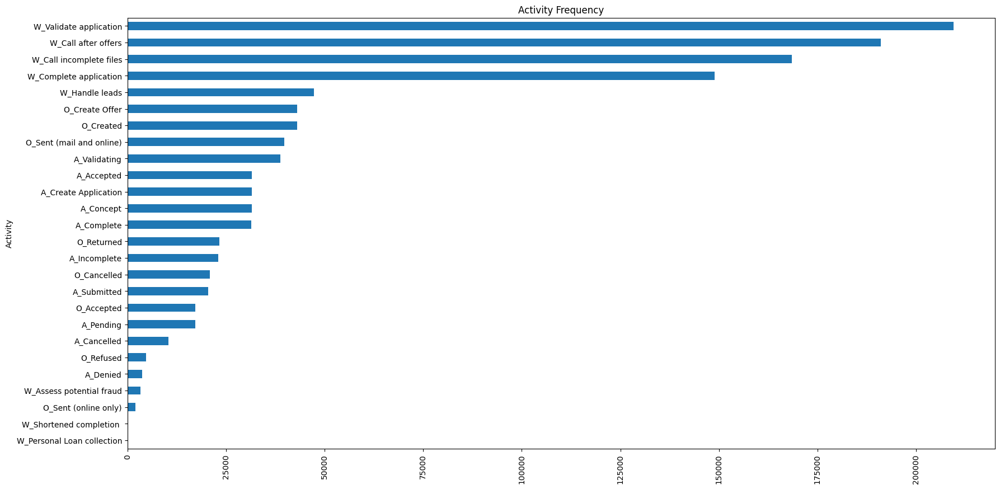

In [24]:
# Horizontal Graphic of the activities total frequency 
plt.figure(figsize=(20,10))
#sns.countplot(x='Activity', data=event_log, order=event_log['Activity'].value_counts().index)
#x-axis should be the frequency of the activities
event_log['Activity'].value_counts().sort_values().plot(kind='barh')
plt.title('Activity Frequency')
plt.xticks(rotation=90)
plt.show()
    

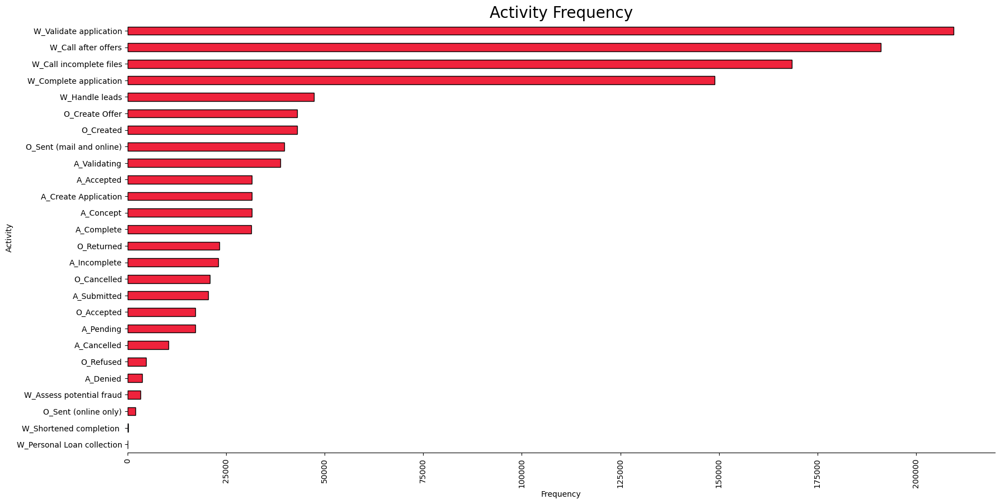

In [25]:
# Create a figure and a set of subplots
fig, ax = plt.subplots(figsize=(20, 10))

SIZE_DEFAULT = 10
SIZE_LARGE = 14
SIZE_BIG = 20
plt.rc("font", family='sans-serif')  # controls default font
plt.rc("font", weight="normal")  # controls default font
plt.rc("font", size=SIZE_BIG)  # controls default text sizes
plt.rc("axes", titlesize=SIZE_BIG)  # fontsize of the axes title
plt.rc("axes", labelsize=SIZE_BIG)  # fontsize of the x and y labels
plt.rc("xtick", labelsize=SIZE_LARGE)  # fontsize of the tick labels
plt.rc("ytick", labelsize=SIZE_LARGE)  # fontsize of the tick labels

# Plot the horizontal bar plot
event_log['Activity'].value_counts().sort_values().plot(kind='barh', ax=ax, color="#EF233C", edgecolor='black')

# Set labels and title
ax.set_xlabel('Frequency')
ax.set_ylabel('Activity')
ax.set_title('Activity Frequency')

# Rotate x-axis labels
plt.xticks(rotation=90)

# Remove spines
ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["top"].set_visible(False)

# Show plot
plt.show()

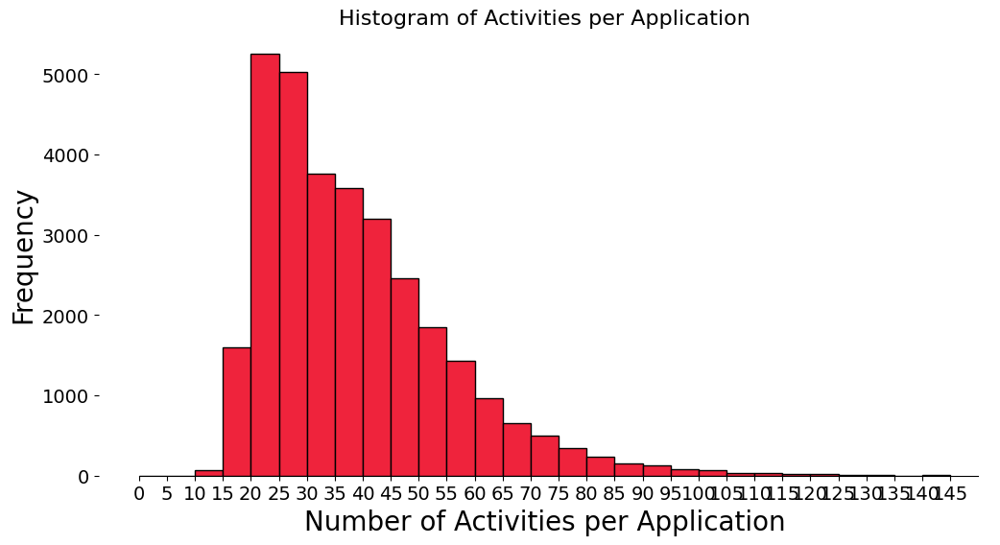

In [26]:
import matplotlib.pyplot as plt

# Assuming 'event_log' is already defined
data = event_log.groupby('caseID')['Activity'].value_counts().unstack().sum(axis=1)

color = "#EF233C"
# Create a figure and a set of subplots
fig, ax = plt.subplots(figsize = (12,6))

SIZE_DEFAULT = 10
SIZE_LARGE = 16
plt.rc("font", family="sans-serif")  # controls default font
plt.rc("font", weight="normal")  # controls default font
plt.rc("font", size=SIZE_DEFAULT)  # controls default text sizes
plt.rc("axes", titlesize=SIZE_LARGE)  # fontsize of the axes title
plt.rc("axes", labelsize=SIZE_DEFAULT)  # fontsize of the x and y labels
plt.rc("xtick", labelsize=SIZE_DEFAULT)  # fontsize of the tick labels
plt.rc("ytick", labelsize=SIZE_DEFAULT)  # fontsize of the tick labels

# Create histogram on the created axes
ax.hist(data, bins=np.arange(0,150,5), color = color, edgecolor = 'black')  # 'auto' automatically determines the number of bins

# Set labels and title
ax.set_xlabel('Number of Activities per Application')
ax.set_ylabel('Frequency')
ax.set_title('Histogram of Activities per Application')

ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["top"].set_visible(False)

ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
ax.spines["bottom"].set_bounds(0, 150)
ax.set_xticks(np.arange(0, 150, 5))

# Show plot
plt.show()

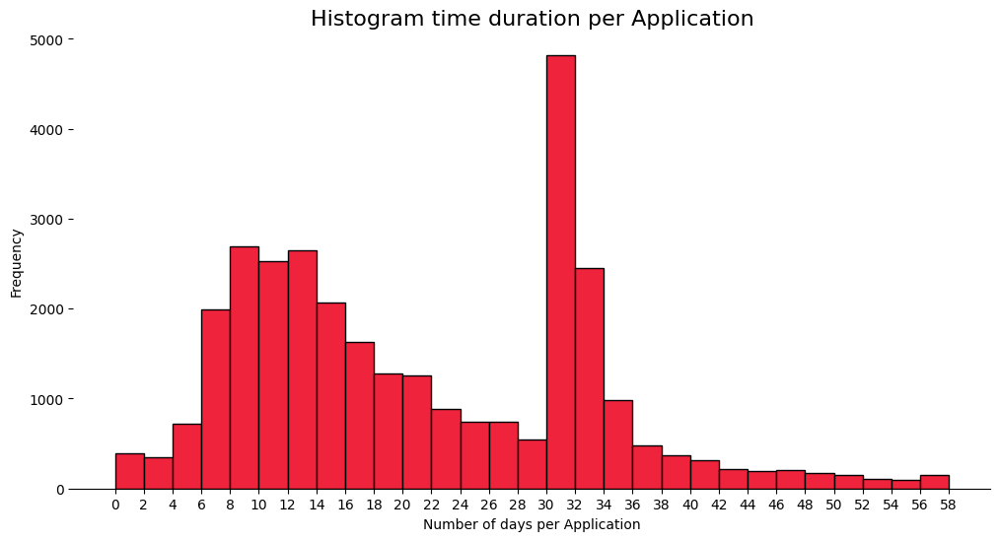

In [27]:
# Histogram of process duration. 
data = event_log.groupby('caseID').agg({'timestamp': ['min', 'max']}).apply(lambda x: (x['timestamp']['max'] - x['timestamp']['min']).days, axis=1)

color = "#EF233C"
# Create a figure and a set of subplots
fig, ax = plt.subplots(figsize = (12,6))

SIZE_DEFAULT = 10
SIZE_LARGE = 16
plt.rc("font", family="sans-serif")  # controls default font
plt.rc("font", weight="normal")  # controls default font
plt.rc("font", size=SIZE_DEFAULT)  # controls default text sizes
plt.rc("axes", titlesize=SIZE_LARGE)  # fontsize of the axes title
plt.rc("axes", labelsize=SIZE_DEFAULT)  # fontsize of the x and y labels
plt.rc("xtick", labelsize=SIZE_DEFAULT)  # fontsize of the tick labels
plt.rc("ytick", labelsize=SIZE_DEFAULT)  # fontsize of the tick labels

# Create histogram on the created axes
ax.hist(data, bins=np.arange(0,60,2), color=color, edgecolor='black')  # 'auto' automatically determines the number of bins

# Set labels and title
ax.set_xlabel('Number of days per Application')
ax.set_ylabel('Frequency')
ax.set_title('Histogram time duration per Application')

ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["top"].set_visible(False)

ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")

ax.set_xticks(np.arange(0, 60, 2))


# Show plot
plt.show()



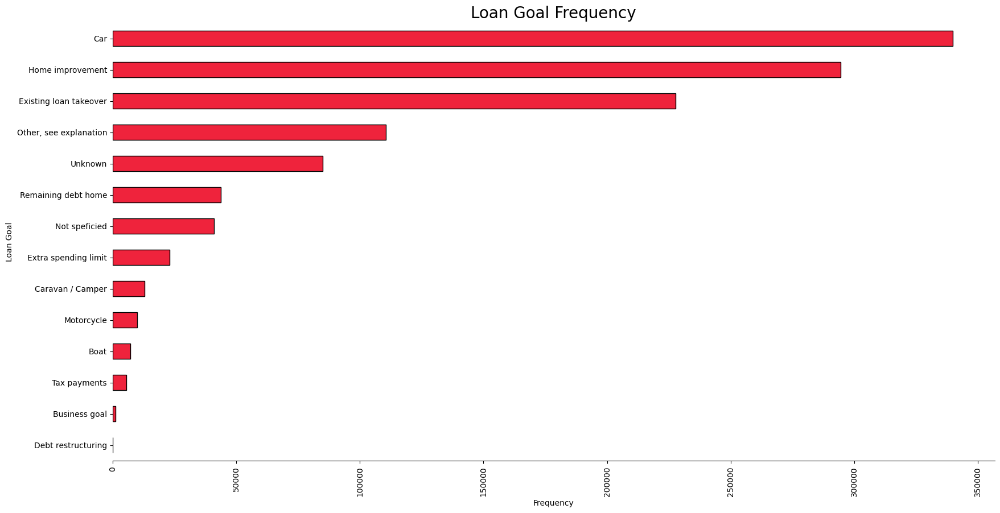

In [28]:
# Histogram of Loan Goal
data = event_log['LoanGoal'].value_counts()
# Create a figure and a set of subplots
fig, ax = plt.subplots(figsize=(20, 10))

SIZE_DEFAULT = 10
SIZE_LARGE = 14
SIZE_BIG = 20
plt.rc("font", family='sans-serif')  # controls default font
plt.rc("font", weight="normal")  # controls default font
plt.rc("font", size=SIZE_BIG)  # controls default text sizes
plt.rc("axes", titlesize=SIZE_BIG)  # fontsize of the axes title
plt.rc("axes", labelsize=SIZE_BIG)  # fontsize of the x and y labels
plt.rc("xtick", labelsize=SIZE_LARGE)  # fontsize of the tick labels
plt.rc("ytick", labelsize=SIZE_LARGE)  # fontsize of the tick labels

# Plot the horizontal bar plot in descending order
data.sort_values().plot(kind='barh', ax=ax, color="#EF233C", edgecolor='black')

# Set labels and title
ax.set_xlabel('Frequency')
ax.set_ylabel('Loan Goal')
ax.set_title('Loan Goal Frequency')

# Rotate x-axis labels
plt.xticks(rotation=90)

# Remove spines
ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["top"].set_visible(False)

# Show plot
plt.show()

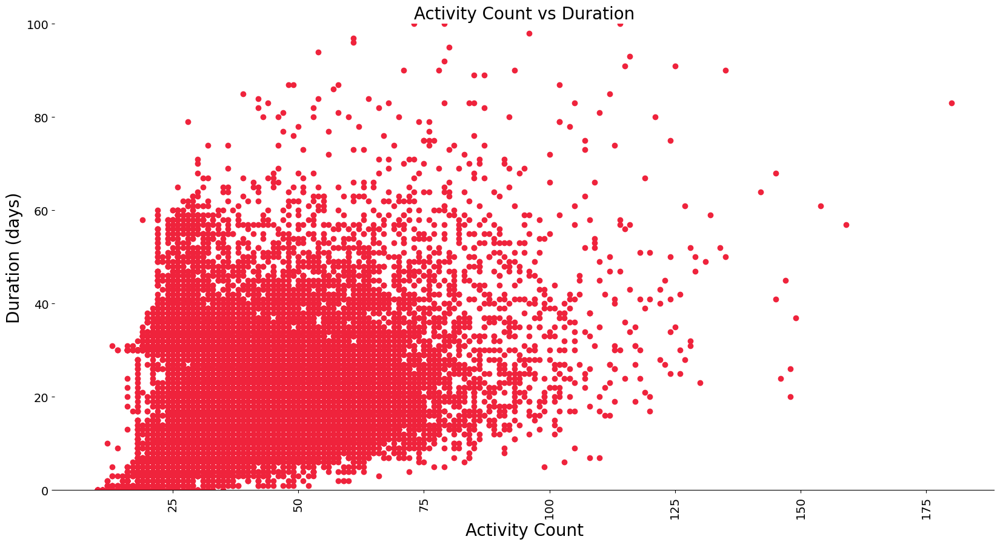

In [58]:
# Dot chart to see the relation between the number of activities and the duration of the process.

# Group by caseID and calculate the number of activities and the duration of the process
data = event_log.groupby('caseID').agg({'Activity': 'count', 'time: timestamp': ['min', 'max']})
data['duration'] = (data['timestamp']['max'] - data['timestamp']['min']).dt.days

fig, ax = plt.subplots(figsize=(20, 10))

SIZE_DEFAULT = 10
SIZE_LARGE = 14
SIZE_BIG = 20
plt.rc("font", family='sans-serif')  # controls default font
plt.rc("font", weight="normal")  # controls default font
plt.rc("font", size=SIZE_BIG)  # controls default text sizes
plt.rc("axes", titlesize=SIZE_BIG)  # fontsize of the axes title
plt.rc("axes", labelsize=SIZE_BIG)  # fontsize of the x and y labels
plt.rc("xtick", labelsize=SIZE_LARGE)  # fontsize of the tick labels
plt.rc("ytick", labelsize=SIZE_LARGE)  # fontsize of the tick labels

# Plot the scatter plot
ax.scatter(data['Activity'], data['duration'], color="#EF233C")



# Set labels and title
ax.set_xlabel('Activity Count')
ax.set_ylabel('Duration (days)')
ax.set_title('Activity Count vs Duration')

# Rotate x-axis labels
plt.xticks(rotation=90)

# Remove spines
ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["top"].set_visible(False)

# Set y-axis limits
ax.set_ylim(0, 100)

# Show plot
plt.show()

In [67]:
activity_series = data['Activity'].squeeze()

# Now calculate the correlation with 'duration', which is assumed to be a Series
correlation = activity_series.corr(data['duration'])

# Print the correlation
print(correlation)

0.11771693796077941


There is no correlation between the number of activities and the time of the process. 

In [29]:
from pm4py.discovery import discover_process_tree_inductive as tree_inductive

process_tree = tree_inductive(event_log, activity_key='Activity', timestamp_key='timestamp', case_id_key='caseID')

In [30]:
import os
print(os.environ['PATH'])
os.environ["PATH"] += os.pathsep + 'C:/Program Files/Graphviz/bin'

c:\Program Files\Python311;c:\Users\pablo\AppData\Roaming\Python\Python311\Scripts;C:\Program Files\Python311\;C:\Program Files (x86)\Common Files\Oracle\Java\javapath;C:\Program Files (x86)\Intel\Intel(R) Management Engine Components\iCLS\;C:\Program Files\Intel\Intel(R) Management Engine Components\iCLS\;C:\Windows\system32;C:\Windows;C:\Windows\System32\Wbem;C:\Windows\System32\WindowsPowerShell\v1.0\;C:\Windows\System32\OpenSSH\;C:\Program Files (x86)\Intel\Intel(R) Management Engine Components\DAL;C:\Program Files\Intel\Intel(R) Management Engine Components\DAL;C:\Program Files (x86)\Intel\Intel(R) Management Engine Components\IPT;C:\Program Files\Intel\Intel(R) Management Engine Components\IPT;C:\Program Files\Intel\WiFi\bin\;C:\Program Files\Common Files\Intel\WirelessCommon\;C:\WINDOWS\system32;C:\WINDOWS;C:\WINDOWS\System32\Wbem;C:\WINDOWS\System32\WindowsPowerShell\v1.0\;C:\WINDOWS\System32\OpenSSH\;C:\Program Files\OpenVPN\bin;C:\Program Files (x86)\NVIDIA Corporation\PhysX\

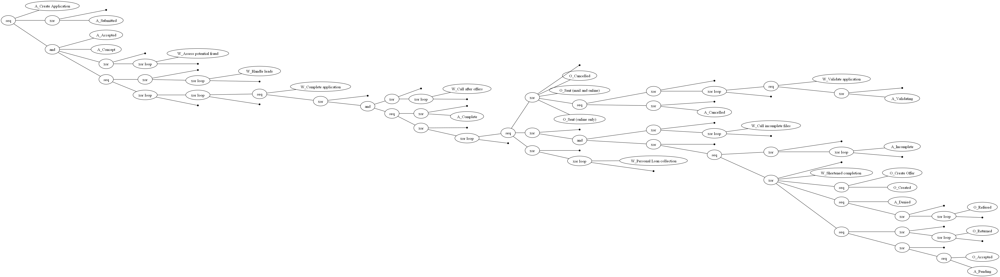

In [31]:
# Visualize the process tree
pm4py.view_process_tree(process_tree, format="png")

In [32]:
dfg, start_activities, end_activities = pm4py.discovery.discover_dfg(event_log, activity_key='Activity', timestamp_key='timestamp', case_id_key='caseID')

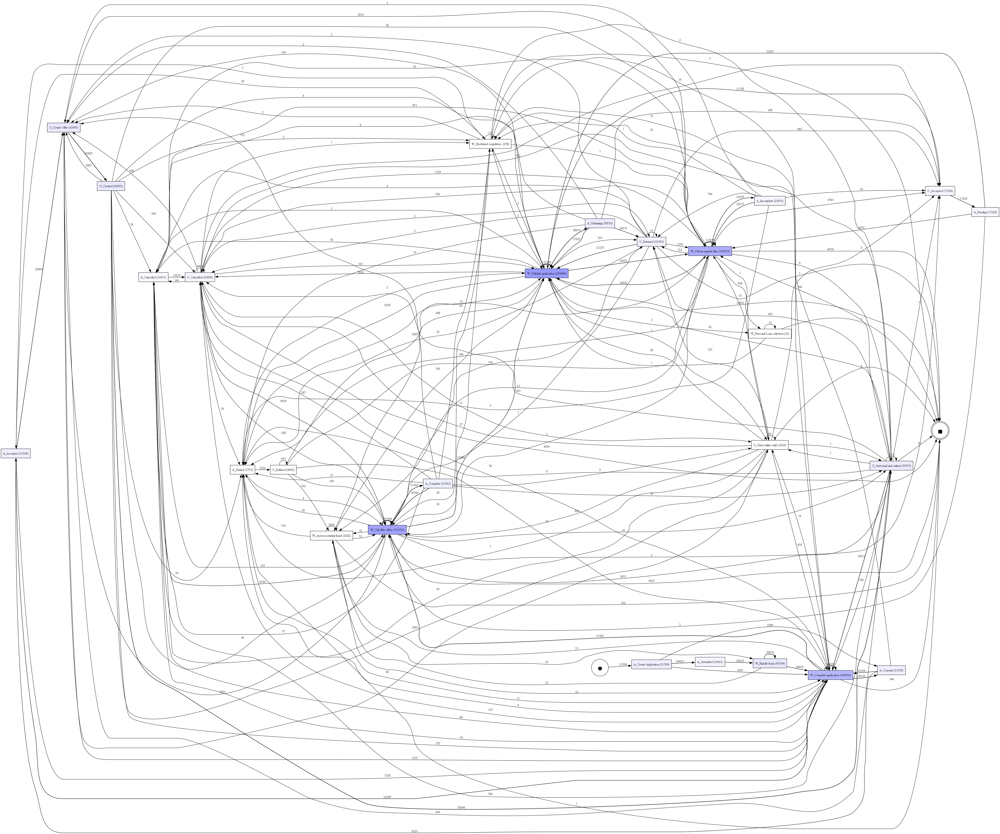

In [33]:
# Spaghetti Model
pm4py.vis.view_dfg(dfg, start_activities, end_activities)

In [34]:
# Inductive Miner BPMN Model

bpmn = pm4py.discovery.discover_bpmn_inductive(event_log, noise_threshold= 0.9,activity_key='Activity', timestamp_key='timestamp', case_id_key='caseID')

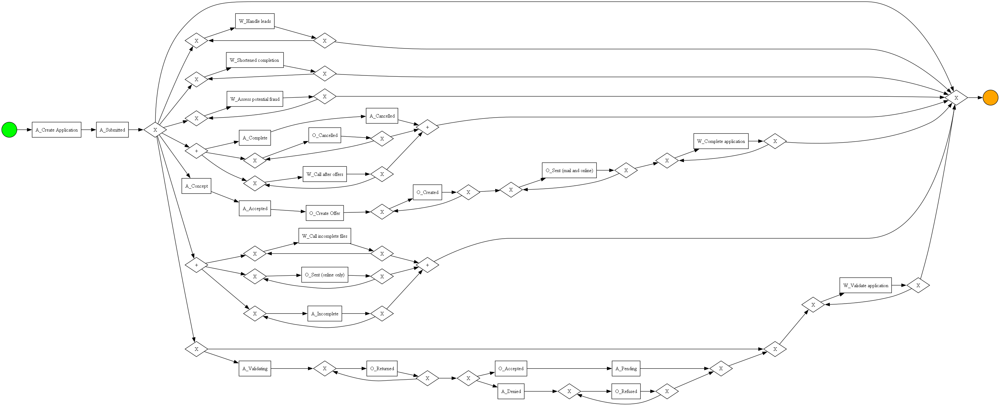

In [35]:
pm4py.vis.view_bpmn(bpmn)

**Dependency threshold**: es el umbral que se establece para determinar si una actividad depende de otra actividad. Si el valor del dependency threshold es alto, significa que se requiere una gran cantidad de actividades en común para que dos actividades se consideren dependientes.

**Threshold**: es el umbral que se establece para determinar la frecuencia mínima con la que una actividad debe ocurrir para ser considerada relevante. Si el valor del threshold es alto, significa que una actividad debe ocurrir con mucha frecuencia para ser considerada importante.

**Loop two threshold**: es el umbral establecido para determinar cuántas veces una actividad puede ocurrir dentro de un bucle antes de ser considerada un "loop de dos" (dos actividades que se repiten). Si el valor del loop two threshold es alto, significa que se requiere un mayor número de repeticiones para que dos actividades sean consideradas un loop de dos.

In [36]:
heuristic_net = pm4py.discovery.discover_heuristics_net(event_log,dependency_threshold = 0.8, and_threshold = 0.7, loop_two_threshold = 0.5, activity_key='Activity', timestamp_key='timestamp', case_id_key='caseID' )

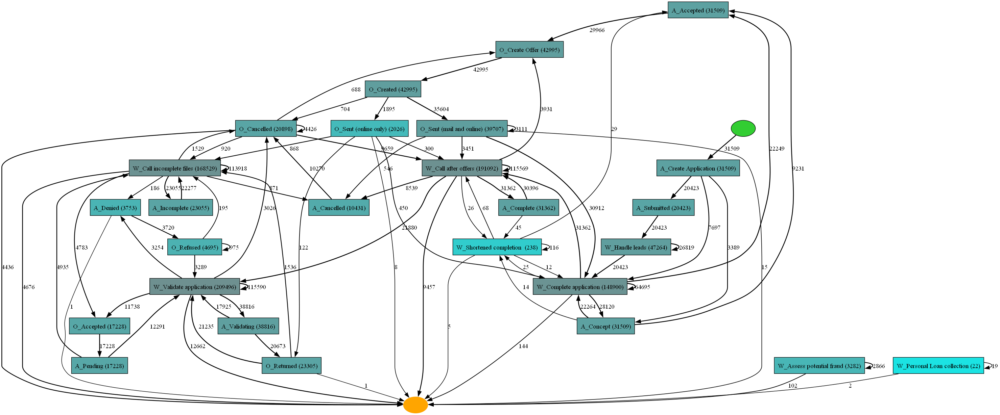

In [37]:
pm4py.vis.view_heuristics_net(heuristic_net)

In [72]:
heuristic_net = pm4py.discovery.discover_heuristics_net(event_log,dependency_threshold = 0.9, and_threshold = 0.7, loop_two_threshold = 0.5, activity_key='Activity', timestamp_key='timestamp', case_id_key='caseID' )

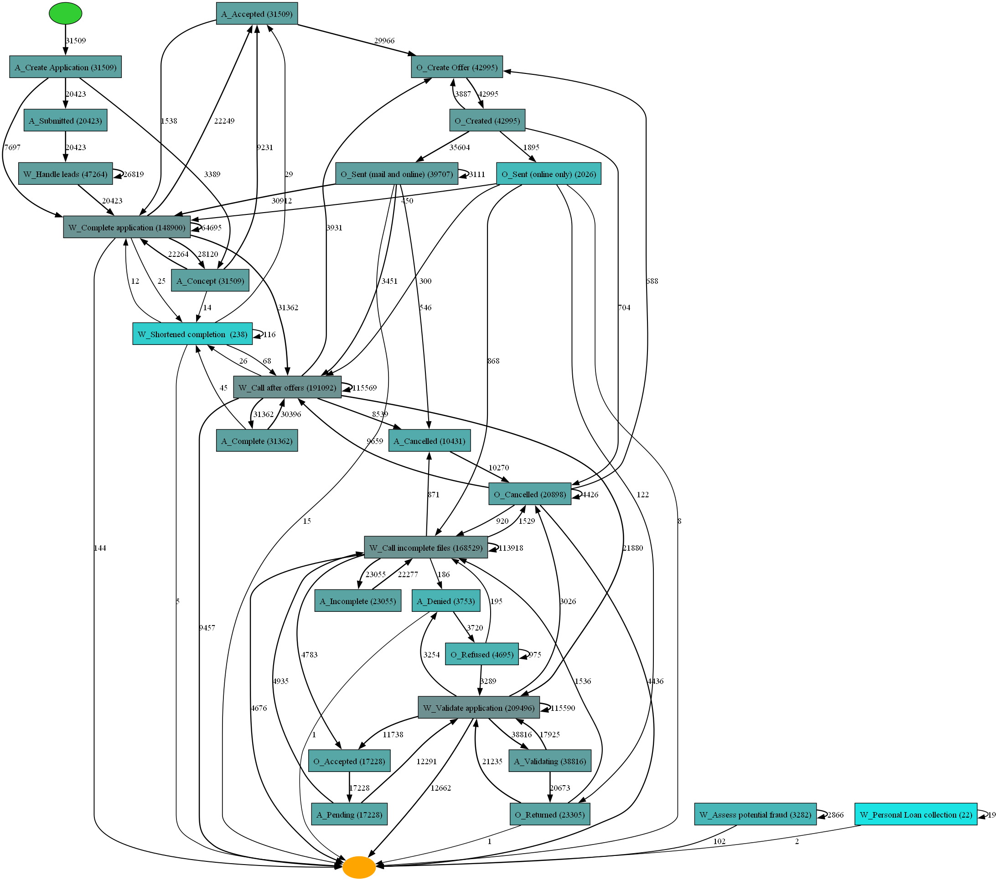

In [73]:
pm4py.vis.view_heuristics_net(heuristic_net)

In [45]:
# PM4PY can also used to calculate statistics of the process model
pm4py.stats.get_service_time(event_log, aggregation_measure='sum', activity_key='Activity', timestamp_key='timestamp', start_timestamp_key='start_timestamp', case_id_key='caseID')

{'A_Accepted': 0.0,
 'A_Cancelled': 0.0,
 'A_Complete': 0.0,
 'A_Concept': 0.0,
 'A_Create Application': 0.0,
 'A_Denied': 0.0,
 'A_Incomplete': 0.0,
 'A_Pending': 0.0,
 'A_Submitted': 0.0,
 'A_Validating': 0.0,
 'O_Accepted': 0.0,
 'O_Cancelled': 0.0,
 'O_Create Offer': 0.0,
 'O_Created': 0.0,
 'O_Refused': 0.0,
 'O_Returned': 0.0,
 'O_Sent (mail and online)': 0.0,
 'O_Sent (online only)': 0.0,
 'W_Assess potential fraud': 0.0,
 'W_Call after offers': 0.0,
 'W_Call incomplete files': 0.0,
 'W_Complete application': 0.0,
 'W_Handle leads': 0.0,
 'W_Personal Loan collection': 0.0,
 'W_Shortened completion ': 0.0,
 'W_Validate application': 0.0}

In [47]:
pm4py.stats.get_variants_paths_duration(event_log,activity_key='Activity', timestamp_key='timestamp', case_id_key='caseID')

,@@index_in_trace,@@flow_time,@@cumulative_occ_path_column,Activity,Activity_2,@@variant_column,@@variant_count
0,0,3.658352e-01,0,A_Create Application,A_Submitted,"(A_Create Application, A_Submitted, W_Handle l...",1056
1,1,3.366061e-01,0,A_Submitted,W_Handle leads,"(A_Create Application, A_Submitted, W_Handle l...",1056
2,2,6.183727e+01,0,W_Handle leads,W_Handle leads,"(A_Create Application, A_Submitted, W_Handle l...",1056
3,3,1.146970e-02,0,W_Handle leads,W_Complete application,"(A_Create Application, A_Submitted, W_Handle l...",1056
4,4,6.297348e-03,0,W_Complete application,A_Concept,"(A_Create Application, A_Submitted, W_Handle l...",1056
...,...,...,...,...,...,...,...
15,15,3.228991e+05,1,W_Call after offers,W_Call after offers,"(A_Create Application, A_Concept, W_Complete a...",1
16,16,2.261100e+01,2,W_Call after offers,W_Call after offers,"(A_Create Application, A_Concept, W_Complete a...",1
17,17,2.324401e+06,0,W_Call after offers,A_Cancelled,"(A_Create Application, A_Concept, W_Complete a...",1
18,18,2.000000e-02,0,A_Cancelled,O_Cancelled,"(A_Create Application, A_Concept, W_Complete a...",1


In [68]:
# Discovering a temporal profile of the model
temporal_profile = pm4py.discover_temporal_profile(event_log, activity_key='Activity', timestamp_key='timestamp', case_id_key='caseID')

In [69]:
temporal_profile

{('A_Accepted', 'A_Cancelled'): (2438949.0475504748, 1031321.609421488),
 ('A_Accepted', 'A_Complete'): (11357.422896371405, 95308.5715152638),
 ('A_Accepted', 'A_Denied'): (1299896.2751454837, 818715.3816384476),
 ('A_Accepted', 'A_Incomplete'): (1222132.0499731945, 851518.250761783),
 ('A_Accepted', 'A_Pending'): (1455123.2369786974, 958004.2294791908),
 ('A_Accepted', 'A_Validating'): (1114877.4139171476, 858087.0801041694),
 ('A_Accepted', 'O_Accepted'): (1455123.2285070235, 958004.2300740546),
 ('A_Accepted', 'O_Cancelled'): (2213398.2979720067, 1320519.8013682137),
 ('A_Accepted', 'O_Create Offer'): (170124.05082479358, 548158.5697642153),
 ('A_Accepted', 'O_Created'): (170125.1135741365, 548158.5994292295),
 ('A_Accepted', 'O_Refused'): (1403193.1552783812, 915386.4828176817),
 ('A_Accepted', 'O_Returned'): (939535.305539498, 704764.7709256583),
 ('A_Accepted', 'O_Sent (mail and online)'): (129454.92299534088,
  471456.9793936117),
 ('A_Accepted', 'O_Sent (online only)'): (10187

In [70]:
net, im, fm = pm4py.discover_petri_net_alpha(event_log, activity_key='Activity', timestamp_key='timestamp', case_id_key='caseID')

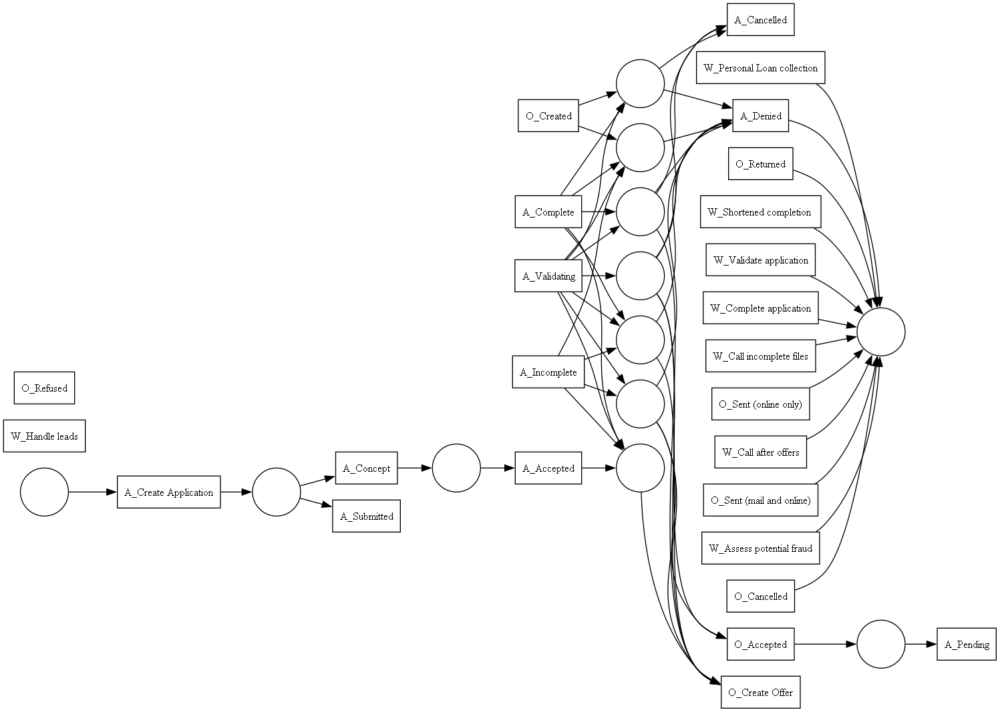

In [71]:
pm4py.vis.view_petri_net(net)

In [77]:
net, im, fm = pm4py.discover_petri_net_ilp(event_log,alpha = 1.0, activity_key='Activity', timestamp_key='timestamp', case_id_key='caseID')

discovering Petri net using ILP miner, completed causal relations ::   0%|          | 0/94 [00:00<?, ?it/s]

In [79]:
pm4py.vis.view_petri_net(net)